In [2]:
from pymatgen.io.vasp.outputs import Vasprun
from pymatgen.io.cif import CifWriter
import numpy as np
import pandas as pd
from m3gnet.models import M3GNet, Potential
from m3gnet.trainers import PotentialTrainer
from m3gnet.layers._atom_ref import AtomRef
import matplotlib.pyplot as plt
import os
import copy
from m3gnet.models import M3GNet, Potential,GraphModelMixin
from m3gnet.trainers import PotentialTrainer
from m3gnet.layers._atom_ref import AtomRef
import warnings
warnings.filterwarnings('ignore')

2023-12-06 15:43:04.260542: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
def traverse_directory(path):
    file_paths = []
    for root, dirs, files in os.walk(path):
        for file in files:
            file_path = os.path.join(root, file)
            if not os.path.isdir(file_path) and not file_path.endswith(".DS_Store"):
                file_paths.append(file_path)
    return file_paths


file_paths_ant = traverse_directory('./antisite')
# file_paths_v = traverse_directory('./vacancy')
# file_path_bulk = traverse_directory('./ref_E/')
file_paths_int = traverse_directory('./interstitial')
print(file_paths_ant)
print(file_paths_int)

['./antisite/Sb2S3/Sb_S/Sb_S_3/Unperturbed/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_30/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_40/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_-30/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_-0/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_-10/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_-20/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_60/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_50/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_10/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_3/Dis_20/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Unperturbed/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_30/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_40/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_-30/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_-0/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_-10/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_-20/vasprun.xml', './antisite/Sb2S3/Sb_S/Sb_S_2/Dis_50/vasprun.xml', './antisite/Sb

In [4]:
selected_steps_int = []
for vasprun_file in file_paths_int:
    
    # print(f'current file is {vasprun_file}')
    
    vasprun = Vasprun(
                    filename=vasprun_file,
                    exception_on_bad_xml=False,
                    # avoid parsing unecesary info
                    parse_potcar_file=False, 
                    parse_dos=False,
                    parse_eigen=False,
                )
    
    # print(f"Calculation converge for {vasprun_file}")
    
    if not vasprun.converged_electronic:
                    print(f"Calculation did not converge for {vasprun_file}. Removing last ionic step.")
                    ionic_steps_tmp = vasprun.ionic_steps[:-1]
    # Then loop over ionic_steps_tmp to check if they are electronically converged
    
    
    temporal_steps = vasprun.ionic_steps
    
    for step in temporal_steps:
       selected_steps_int.append({str(vasprun_file)[14:-12]:
           {
               'e_0_energy': step['e_0_energy'],
               'forces': step['forces'],
               'stress': (np.array(step['stress']) * -0.1).tolist(),  
               # from kPa of VASP output units to GPa used by default in M3GNet
               "structure": step["structure"],
           }})
# checking the data

# for i in selected_steps_int:
#     print(i)


In [5]:
selected_steps_ant = []
for vasprun_file in file_paths_ant:
    
    # print(f'current file is {vasprun_file}')
    
    vasprun = Vasprun(
                    filename=vasprun_file,
                    exception_on_bad_xml=False,
                    # avoid parsing unecesary info
                    parse_potcar_file=False, 
                    parse_dos=False,
                    parse_eigen=False,
                )
    
    # print(f"Calculation converge for {vasprun_file}")
    
    if not vasprun.converged_electronic:
                    print(f"Calculation did not converge for {vasprun_file}. Removing last ionic step.")
                    ionic_steps_tmp = vasprun.ionic_steps[:-1]
    # Then loop over ionic_steps_tmp to check if they are electronically converged
    
    
    temporal_steps = vasprun.ionic_steps
    
    for step in temporal_steps:
       selected_steps_ant.append({str(vasprun_file)[21:-12]:
           {
               'e_0_energy': step['e_0_energy'],
               'forces': step['forces'],
               'stress': (np.array(step['stress']) * -0.1).tolist(),  
               # from kPa of VASP output units to GPa used by default in M3GNet
               "structure": step["structure"],
           }})
# checking the data

# for i in selected_steps_ant:
#     print(i)


In [6]:
# put data into an more readable dictionaty, structure:{'file_path':[{data of 1st ionic step},{data of 2nd ionic step},...]}
dic_int = {}
for i in selected_steps_int:
    for key,value in i.items():
        
        if key in dic_int:
            dic_int[key].append(value)
        else:
            dic_int[key] = [value]
# print (dic_int)

dic_ant = {}
for i in selected_steps_ant:
    for key,value in i.items():
        
        if key in dic_ant:
            dic_ant[key].append(value)
        else:
            dic_ant[key] = [value]
# print (dic_ant)

In [7]:
# put all the e_0_energies in a dictionary, structure:{'file_name':[energies,energies,....]}
e_0_energy_int = {}
for key,value in dic_int.items():
    for i in value:
        
        if key in e_0_energy_int:
            e_0_energy_int[key].append(i['e_0_energy'])
        else:
            e_0_energy_int[key] = [i['e_0_energy']]
print(e_0_energy_int)

e_0_energy_ant = {}
for key,value in dic_ant.items():
    for i in value:
        
        if key in e_0_energy_ant:
            e_0_energy_ant[key].append(i['e_0_energy'])
        else:
            e_0_energy_ant[key] = [i['e_0_energy']]
print(e_0_energy_ant)


{'/Int_Sb/I_Sb_8/Dis_-40': [-203.97923663, -251.6420413, -231.56314979, -104.44663696, -185.71113132, -259.88273032, -289.07680082, -292.63919935, -294.64200777, -294.6822628, -315.1225447, -315.13644055, -319.49146391, -320.76498406, -320.54125025, -321.12052937, -322.95427019, -324.54312649, -325.94438199, -326.47438517, -327.69067333, -327.76043615, -328.75369545, -328.93865566, -329.63107614, -329.68003459, -330.02007486, -330.14318401, -330.38352131, -330.4821912, -330.6766857, -330.77415982, -330.95425149, -331.20832616, -331.52226285, -331.65279204, -331.94440988, -332.03626158, -332.2886203, -332.36420735, -332.57758315, -332.63462688, -332.84579827, -332.89559523, -333.0631365, -333.12824164, -333.27109907, -333.28773171, -333.37726049, -333.38375426, -333.45706568, -333.47631912, -333.53986908, -333.55804737, -333.61209581, -333.62215725, -333.67414355, -333.69233861, -333.7381603, -333.78940848, -333.86773747, -333.9078959, -333.98264304, -334.02007878, -334.07681939, -334.1

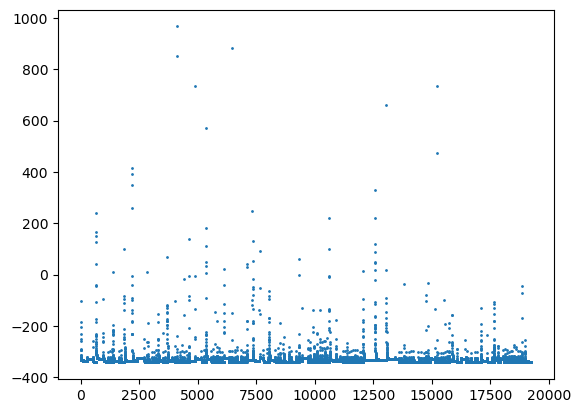

In [8]:
# visulisation of the energies
# count the number of structures in each distortions
total_count = 0
dic_int_count = {}
for key, value in dic_int.items():
    # print(value)
    dic_int_count[key] = len(value)
    total_count = total_count + len(value)
# for key,value in dic_v_count.items():
#     print(key,value)
# print (total_count)
total_count = 0
dic_ant_count = {}
for key, value in dic_ant.items():
    # print(value)
    dic_ant_count[key] = len(value)
    total_count = total_count + len(value)
# for key,value in dic_v_count.items():
#     print(key,value)
# print (total_count)
x_int = []
y_int = []
count = 0
for key, value in dic_int_count.items():
    count += value
# print (count)
for key, value in e_0_energy_int.items(): 
    for i in value:
        y_int.append(i)
x_int = list(range(count))
# print (count)    
# print(x)
plt.scatter(x_int,y_int,marker = 'o', s = 1)
# plt.savefig('e_0_energy_v', dpi=300)

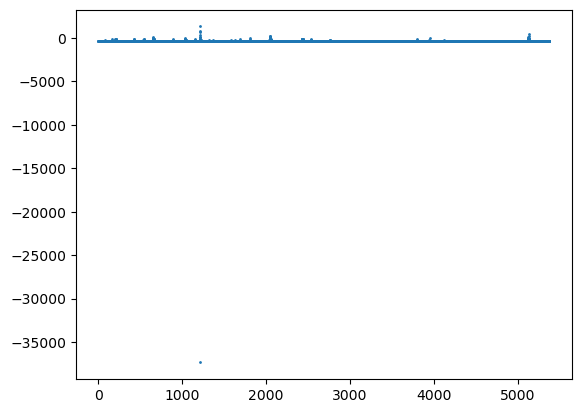

In [9]:
x_ant = []
y_ant = []
count = 0
for key, value in dic_ant_count.items():
    count += value
# print (count)
for key, value in e_0_energy_ant.items(): 
    for i in value:
        y_ant.append(i)
x_ant = list(range(count))
# print (count)    
# print(x)
plt.scatter(x_ant,y_ant,marker = 'o', s = 1)
# plt.savefig('e_0_energy_v', dpi=300)

In [10]:
# output the minmum e_0_energy for all distortions
e_0_energy_int_min = {}
for key, value in e_0_energy_int.items():
    e_0_energy_int_min[key] = min (value)
# print (e_0_energy_v_min)
# listing the minimum e_0_energy
list_of_min_energy_int = []
for key, value in e_0_energy_int_min.items():
    list_of_min_energy_int.append(value)
list_of_min_energy_int.sort()
# print (list_of_min_energy)


# finding the energies that is larger than the half of the minimum e_0_energy
e_0_energy_int_min_haf = e_0_energy_int_min.copy()
for key, value in e_0_energy_int_min_haf.items():
    half = value*0.53
    # 0.53 is choosen as the best boundary, since some structures may misdelete by cheking the cif. file printed in next 2 cells
    e_0_energy_int_min_haf.update({key:half})
for key,value in e_0_energy_int_min_haf.items():
    print (key,value)






e_0_energy_ant_min = {}
for key, value in e_0_energy_ant.items():
    e_0_energy_ant_min[key] = min (value)
# print (e_0_energy_v_min)
# listing the minimum e_0_energy
list_of_min_energy_ant = []
for key, value in e_0_energy_ant_min.items():
    list_of_min_energy_ant.append(value)
list_of_min_energy_ant.sort()
# print (list_of_min_energy)


# finding the energies that is larger than the half of the minimum e_0_energy
e_0_energy_ant_min_haf = e_0_energy_ant_min.copy()
for key, value in e_0_energy_ant_min_haf.items():
    half = value*0.53
    # 0.53 is choosen as the best boundary, since some structures may misdelete by cheking the cif. file printed in next 2 cells
    e_0_energy_ant_min_haf.update({key:half})
for key,value in e_0_energy_ant_min_haf.items():
    print (key,value)

/Int_Sb/I_Sb_8/Dis_-40 -177.5781250012
/Int_Sb/I_Sb_8/Unperturbed -173.4101793492
/Int_Sb/I_Sb_8/Dis_30 -180.41848219680003
/Int_Sb/I_Sb_8/Dis_40 -174.9807835063
/Int_Sb/I_Sb_8/Dis_-30 -179.86018889940001
/Int_Sb/I_Sb_8/Dis_-0 -180.6718425011
/Int_Sb/I_Sb_8/Dis_-10 -180.7763805809
/Int_Sb/I_Sb_8/Dis_-20 -180.7764728433
/Int_Sb/I_Sb_8/Dis_60 -123.93833264450001
/Int_Sb/I_Sb_8/Dis_50 -179.0748280571
/Int_Sb/I_Sb_8/Dis_10 -180.77069809580001
/Int_Sb/I_Sb_8/Dis_20 -180.5507861869
/Int_Sb/I_Sb_8/Dis_-60 -178.2437573701
/Int_Sb/I_Sb_8/Dis_-50 -47.3117735637
/Int_Sb/I_Sb_1/Dis_-40 -178.17827779400002
/Int_Sb/I_Sb_1/Unperturbed -172.96113492530003
/Int_Sb/I_Sb_1/Dis_30 -180.8977880519
/Int_Sb/I_Sb_1/Dis_40 -180.49052845170002
/Int_Sb/I_Sb_1/Dis_-30 -180.7899376152
/Int_Sb/I_Sb_1/Dis_-0 -180.7857211154
/Int_Sb/I_Sb_1/Dis_-10 -180.89791140940002
/Int_Sb/I_Sb_1/Dis_-20 -180.8978474172
/Int_Sb/I_Sb_1/Dis_60 -178.1825517087
/Int_Sb/I_Sb_1/Dis_50 -119.61472796410001
/Int_Sb/I_Sb_1/Dis_10 -180.785654

In [11]:
# finding the structure that need to be remove
e_0_energy_int_rm = {}
for file, energy in e_0_energy_int_min_haf.items():
    for value in e_0_energy_int[file]:
        if  energy < value or value < -400:
                if file in e_0_energy_int_rm:
                    e_0_energy_int_rm[file].append(value)
                else:
                    e_0_energy_int_rm[file] = [value]

print (e_0_energy_int_rm)


e_0_energy_ant_rm = {}
for file, energy in e_0_energy_ant_min_haf.items():
    for value in e_0_energy_ant[file]:
        if  energy < value or value < -400:
                if file in e_0_energy_ant_rm:
                    e_0_energy_ant_rm[file].append(value)
                else:
                    e_0_energy_ant_rm[file] = [value]

print (e_0_energy_ant_rm)

{'/Int_Sb/I_Sb_8/Dis_-40': [-104.44663696], '/Int_Sb/I_Sb_8/Dis_40': [-174.33154291, 240.36053437, 165.01999978, 149.3137088, 125.52149839, 42.40702343, -42.1463164, -46.16919525, -108.17948184], '/Int_Sb/I_Sb_8/Dis_-30': [-96.92078266], '/Int_Sb/I_Sb_8/Dis_50': [8.47958156], '/Int_Sb/I_Sb_8/Dis_-60': [101.30295817, -139.50275825, -93.50767616, -84.68283529, -110.61179346], '/Int_Sb/I_Sb_8/Dis_-50': [414.21399407, 390.36784849, 259.5416331, 349.58242159], '/Int_Sb/I_Sb_1/Dis_-40': [-99.49861321, -6.30425008, -150.7721873, -39.03232457, -138.34235098], '/Int_Sb/I_Sb_1/Dis_40': [9.73943213], '/Int_Sb/I_Sb_1/Dis_60': [-152.95737776], '/Int_Sb/I_Sb_1/Dis_-50': [69.05333157], '/Int_Sb/I_Sb_9/Dis_-40': [-128.19254197, -146.08694893, -148.77554321, -174.79393261], '/Int_Sb/I_Sb_9/Dis_30': [-102.25245077], '/Int_Sb/I_Sb_9/Dis_40': [853.08367773, 966.67855255], '/Int_Sb/I_Sb_9/Dis_-50': [-5.53086652, 139.64473448], '/Int_Sb/I_Sb_2/Dis_-40': [-6.14619801, 736.60044495], '/Int_Sb/I_Sb_2/Dis_-30':

In [12]:
# delete the structures in e_0_energy_v_rm from dic_ and named new_dic_
dic_to_remove_int = []
new_dic_int = copy.deepcopy(dic_int)
for key,value in e_0_energy_int_rm.items():
    for i in new_dic_int[key]:
        # print(type(i))
        for j in value:
            # print(type(j))
            # print (i['e_0_energy'])
            # print (f'current j is {j}')
            if i['e_0_energy'] == j:
                dic_to_remove_int.append(i)

# print (dic_to_remove_int)
for key, value in e_0_energy_int_rm.items():
    for i in dic_to_remove_int:
        if i in new_dic_int[key]:
            new_dic_int[key].remove(i)
            
            
dic_to_remove_ant = []
new_dic_ant = copy.deepcopy(dic_ant)
for key,value in e_0_energy_ant_rm.items():
    for i in new_dic_ant[key]:
        # print(type(i))
        for j in value:
            # print(type(j))
            # print (i['e_0_energy'])
            # print (f'current j is {j}')
            if i['e_0_energy'] == j:
                dic_to_remove_ant.append(i)

# print (dic_to_remove_ant)
for key, value in e_0_energy_ant_rm.items():
    for i in dic_to_remove_ant:
        if i in new_dic_ant[key]:
            new_dic_ant[key].remove(i)

In [13]:
# put all the e_0_energies in a dictionary, structure:{'file_name':[energies,energies,....]}
e_0_energy_int_new = {}
for key,value in new_dic_int.items():
    for i in value:
        
        if key in e_0_energy_int_new:
            e_0_energy_int_new[key].append(i['e_0_energy'])
        else:
            e_0_energy_int_new[key] = [i['e_0_energy']]
print(e_0_energy_int_new)

e_0_energy_ant_new = {}
for key,value in new_dic_ant.items():
    for i in value:
        
        if key in e_0_energy_ant_new:
            e_0_energy_ant_new[key].append(i['e_0_energy'])
        else:
            e_0_energy_ant_new[key] = [i['e_0_energy']]
print(e_0_energy_ant_new)


{'/Int_Sb/I_Sb_8/Dis_-40': [-203.97923663, -251.6420413, -231.56314979, -185.71113132, -259.88273032, -289.07680082, -292.63919935, -294.64200777, -294.6822628, -315.1225447, -315.13644055, -319.49146391, -320.76498406, -320.54125025, -321.12052937, -322.95427019, -324.54312649, -325.94438199, -326.47438517, -327.69067333, -327.76043615, -328.75369545, -328.93865566, -329.63107614, -329.68003459, -330.02007486, -330.14318401, -330.38352131, -330.4821912, -330.6766857, -330.77415982, -330.95425149, -331.20832616, -331.52226285, -331.65279204, -331.94440988, -332.03626158, -332.2886203, -332.36420735, -332.57758315, -332.63462688, -332.84579827, -332.89559523, -333.0631365, -333.12824164, -333.27109907, -333.28773171, -333.37726049, -333.38375426, -333.45706568, -333.47631912, -333.53986908, -333.55804737, -333.61209581, -333.62215725, -333.67414355, -333.69233861, -333.7381603, -333.78940848, -333.86773747, -333.9078959, -333.98264304, -334.02007878, -334.07681939, -334.12986872, -334.1

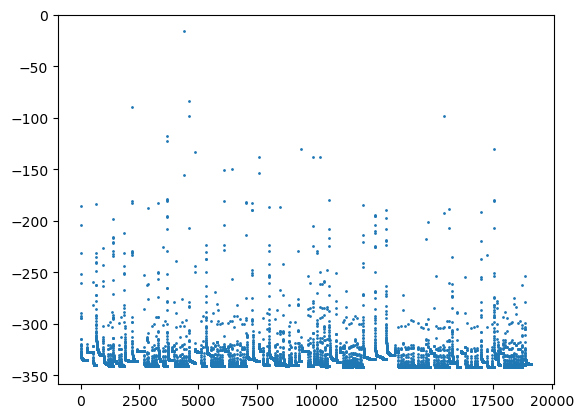

In [14]:
# visulisation of the energies
# count the number of structures in each distortions
total_count = 0
new_dic_int_count = {}
for key, value in new_dic_int.items():
    # print(value)
    new_dic_int_count[key] = len(value)
    total_count = total_count + len(value)
# for key,value in dic_v_count.items():
#     print(key,value)
# print (total_count)
total_count = 0
new_dic_ant_count = {}
for key, value in new_dic_ant.items():
    # print(value)
    new_dic_ant_count[key] = len(value)
    total_count = total_count + len(value)
# for key,value in dic_v_count.items():
#     print(key,value)
# print (total_count)
x_int_new = []
y_int_new = []
count = 0
for key, value in new_dic_int_count.items():
    count += value
# print (count)
for key, value in e_0_energy_int_new.items(): 
    for i in value:
        y_int_new.append(i)
x_int_new = list(range(count))
# print (count)    
# print(x)
plt.scatter(x_int_new,y_int_new,marker = 'o', s = 1)
# plt.savefig('e_0_energy_v', dpi=300)

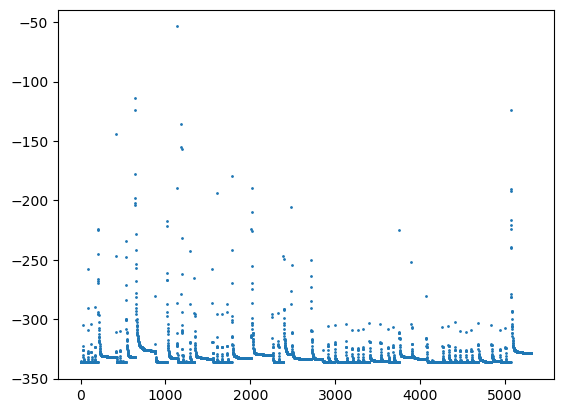

In [15]:
x_ant_new = []
y_ant_new = []
count = 0
for key, value in new_dic_ant_count.items():
    count += value
# print (count)
for key, value in e_0_energy_ant_new.items(): 
    for i in value:
        y_ant_new.append(i)
x_ant_new = list(range(count))
# print (count)    
# print(x)
plt.scatter(x_ant_new,y_ant_new,marker = 'o', s = 1)
# plt.savefig('e_0_energy_v', dpi=300)

In [16]:
# # count the number of structures in each distortions
# total_count = 0
# dic_v_count = {}
# for key, value in dic_v.items():
#     # print(value)
#     dic_v_count[key] = len(value)
#     total_count = total_count + len(value)
# # for key,value in dic_v_count.items():
# #     print(key,value)
# # print (total_count)

In [17]:
test_dic_int = {}
for key,value in new_dic_int.items():
    num_of_structures = len(value) - 1
    if num_of_structures <= 20 :
        test_dic_int[key] = value
    elif len(value) > 20 :
        selected_index = np.linspace(0, num_of_structures, 20, dtype=int)
        # print (key,len(value),selected_index)
        test_dic_int[key] = [value[index] for index in selected_index]
        
test_dic_ant = {}
for key,value in new_dic_ant.items():
    num_of_structures = len(value) - 1
    if num_of_structures <= 20 :
        test_dic_ant[key] = value
    elif len(value) > 20 :
        selected_index = np.linspace(0, num_of_structures, 20, dtype=int)
        # print (key,len(value),selected_index)
        test_dic_ant[key] = [value[index] for index in selected_index]


In [18]:
def listing_element(dic,element):
    list_of_element = []
    for key,value in dic.items():
        for i in value:
            list_of_element.append(i[element])
    return list_of_element

In [19]:
test_int = {
    'energy': listing_element(test_dic_int, 'e_0_energy'),
    'forces': listing_element(test_dic_int, 'forces'),
    'stress': listing_element(test_dic_int, 'stress'),
    'structure': listing_element(test_dic_int, 'structure')
}

test_ant = {
    'energy': listing_element(test_dic_ant, 'e_0_energy'),
    'forces': listing_element(test_dic_ant, 'forces'),
    'stress': listing_element(test_dic_ant, 'stress'),
    'structure': listing_element(test_dic_ant, 'structure')
}

In [20]:
import pickle
# with open('test_int.pkl', 'wb') as file:
#     pickle.dump(test_int, file)
# with open('test_ant.pkl', 'wb') as file:
#     pickle.dump(test_ant, file)

In [21]:
# print(test_dic_int)

{'/Int_Sb/I_Sb_8/Dis_-40': [{'e_0_energy': -203.97923663, 'forces': [[0.87761482, 5.07216338, 11.1325583], [1.03345319, -1.01286621, -0.99201457], [-0.02567888, -1.14998968, 1.68078113], [3.16379876, -4.2507735, -2.74735826], [-1.14560092, 1.23655617, -2.6340273], [-3.36712332, 6.47981746, -18.13694876], [1.29815465, 1.34643667, -0.53852907], [-0.59773872, -0.45331893, 0.33708786], [3.35727119, -5.56609912, 18.93567815], [-1.04559246, -0.6098492, 0.59204329], [-0.76527812, -0.41492527, 0.69550022], [0.22614645, 3.17836701, 0.76031209], [-1.24917409, -0.21461825, -0.89384917], [1.18777236, -2.39476613, -3.09761277], [-0.85620419, -7.68681074, 9.79961265], [1.29484126, -4.43716401, 4.55472266], [-0.73943998, -3.73364013, 4.7366101], [0.01831206, -0.12867282, -1.93120815], [-8.48021003, 2.53006496, -7.60701138], [-2.69027879, -1.5349474, -7.19987322], [1.70050843, 1.62740436, 1.29788595], [-0.05518565, 1.55182337, 0.23626242], [0.03906376, 0.03949379, -1.67173963], [3.59308854, 12.2236359

In [31]:
# int_energy = {}
# for key,value in test_dic_int.items():
#     for i in value:
#         if key in int_energy:
#             int_energy[key].append(i['e_0_energy'])
#         else:
#             int_energy[key] = [i['e_0_energy']]
        
# # print(int_energy)
# with open('int_energy_dic.pkl','wb') as file:
#     pickle.dump(int_energy, file)